# Annotations using clustering for cells for skin_s3

In [1]:
slide_id = "skin_s3"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_skin_s3.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 22673, 20342), (3, 11337, 10171)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (106980, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (106980, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (106980, 282)
      └── 'table_nuclei': AnnData (106980, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 106980 × 282
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,34,0,0,0,0,34,640.225336,12.056719,cell_labels
1,aaaaaaab-1,17,0,0,0,0,17,570.504083,8.173282,cell_labels
2,aaaaaaac-1,1217,0,0,1,0,1218,581.025490,45.698127,cell_labels
3,aaaaaaad-1,296,0,0,0,0,296,296.270167,16.211094,cell_labels
4,aaaaaaae-1,61,0,0,0,0,61,800.891279,11.560000,cell_labels
...,...,...,...,...,...,...,...,...,...,...
106975,aaabkbnp-1,157,0,0,0,0,157,95.099066,24.610157,cell_labels
106976,aaabkboa-1,300,0,0,0,0,300,206.905945,11.424532,cell_labels
106977,aaabkbob-1,37,0,0,0,0,37,339.529856,17.656094,cell_labels
106978,aaabkboc-1,72,0,0,0,0,72,117.677192,14.991876,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ACER1,ENSG00000167769,Gene Expression,Unknown
ACHE,ENSG00000087085,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ADAM12,ENSG00000148848,Gene Expression,Unknown
AHNAK2,ENSG00000185567,Gene Expression,Unknown
...,...,...,...
UBE2C,ENSG00000175063,Gene Expression,Unknown
VIM,ENSG00000026025,Gene Expression,Unknown
VWF,ENSG00000110799,Gene Expression,Unknown
WDFY4,ENSG00000128815,Gene Expression,Unknown


In [3]:
adata_nuclei = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 100786 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,42.537377,Mast cell,175,2,4,8,4,Epithelial,Keratinocyte,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,14.901764,APCDD1 fibroblast,33,0,3,1,3,Melanocyte,High_proliferating_melanocyte,cancer_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,20.546308,Granular keratinocyte,27,2,4,8,4,Epithelial,Keratinocyte,normal_cell
aaaaaaah-1,nucleus_boundaries,morpho,aaaaaaah-1,29.465128,WISP2 fibroblast,80,1,5,7,5,Fibroblast,CAF,normal_cell
aaaaaaai-1,nucleus_boundaries,morpho,aaaaaaai-1,17.565349,MMP1 fibroblast,17,1,5,7,5,Fibroblast,CAF,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaabkbno-1,nucleus_boundaries,morpho,aaabkbno-1,19.665156,MMP1 fibroblast,24,1,5,7,5,Fibroblast,CAF,normal_cell
aaabkbnp-1,nucleus_boundaries,morpho,aaabkbnp-1,22.510450,Naive B,46,2,4,8,4,Epithelial,Keratinocyte,normal_cell
aaabkboa-1,nucleus_boundaries,morpho,aaabkboa-1,10.363265,Basal keratinocyte,25,2,4,8,4,Epithelial,Keratinocyte,normal_cell
aaabkboc-1,nucleus_boundaries,morpho,aaabkboc-1,13.501725,APOE fibroblast,17,1,5,7,5,Fibroblast,CAF,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ACER1,0.127410,0.780908
ACHE,0.086231,0.637528
ACTA2,0.178257,0.925989
ADAM12,0.659202,1.683597
AHNAK2,0.402893,1.355265
...,...,...
UBE2C,0.376534,1.305118
VIM,4.290421,2.563181
VWF,0.252929,1.136477
WDFY4,0.130961,0.836525


## 2. Preprocessing

<Axes: >

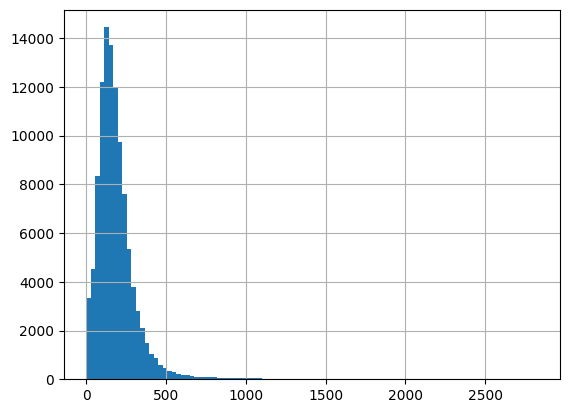

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

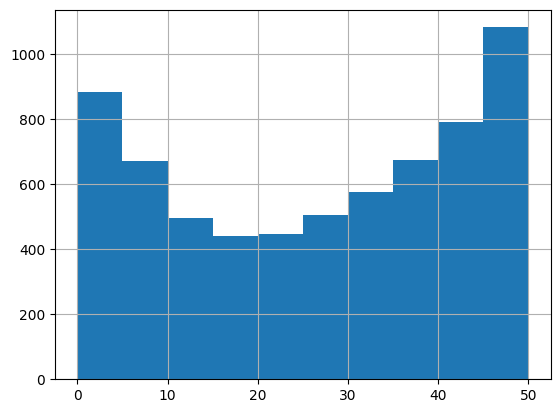

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 2492
Percentage of cells with less than 20 transcripts: 2.33%
-----
Number of cells with less than 15 transcripts: 2051
Percentage of cells with less than 15 transcripts: 1.92%
-----
Number of cells with less than 10 transcripts: 1556
Percentage of cells with less than 10 transcripts: 1.45%
-----
Number total of cells: 106980


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

105303


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


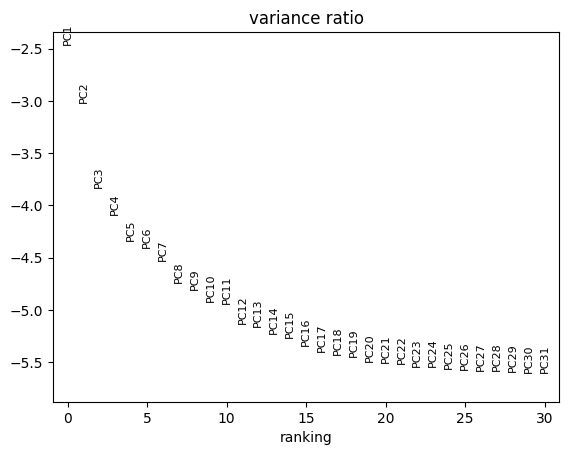

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 105303 × 282
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_2495/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


In [46]:
sc.tl.leiden(adata_cells, resolution=0.8, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.8', neighbors_key='pca_n10_pcs16')

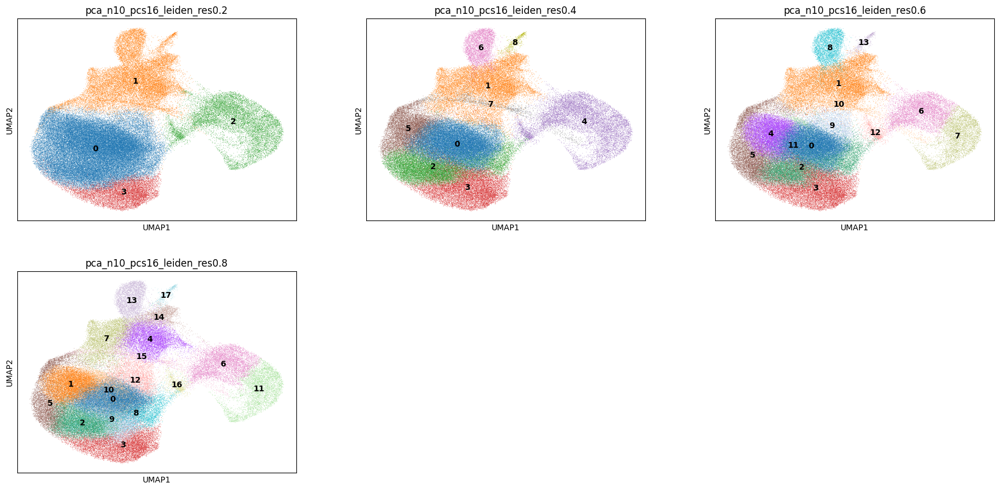

In [47]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.8'],
           ncols=3, legend_loc='on data')

In [24]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].unique()

['1', '2', '3', '0']
Categories (4, object): ['0', '1', '2', '3']

In [48]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['3']), 'refine_res'] = '3'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['13']), 'refine_res'] = '8'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.8'].isin(['4']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.8'].isin(['14']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.8'].isin(['15']), 'refine_res'] = '11'

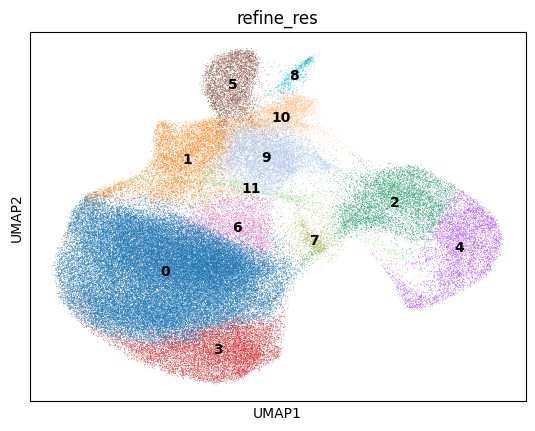

In [49]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [50]:
clustering_label = 'refine_res'

In [51]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

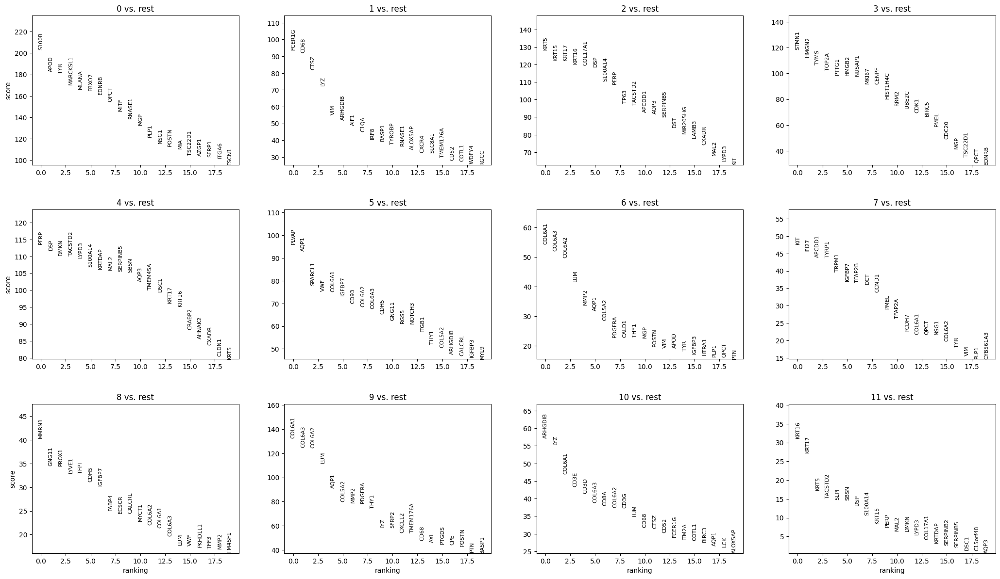

In [52]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [53]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [54]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [55]:
cluster_id = '0'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Melanocyte,Melanocyte,cancer_cell,87.3
1,Melanocyte,Melanocyte,normal_cell,6.9
2,Melanocyte,High_proliferating_melanocyte,cancer_cell,4.5
3,NA,NA,NA,0.8
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.5


In [57]:
top_ranked_genes[cluster_id]

0       S100B
1        APOD
2         TYR
3    MARCKSL1
4       MLANA
5       FBXO7
6       EDNRB
Name: 0, dtype: object

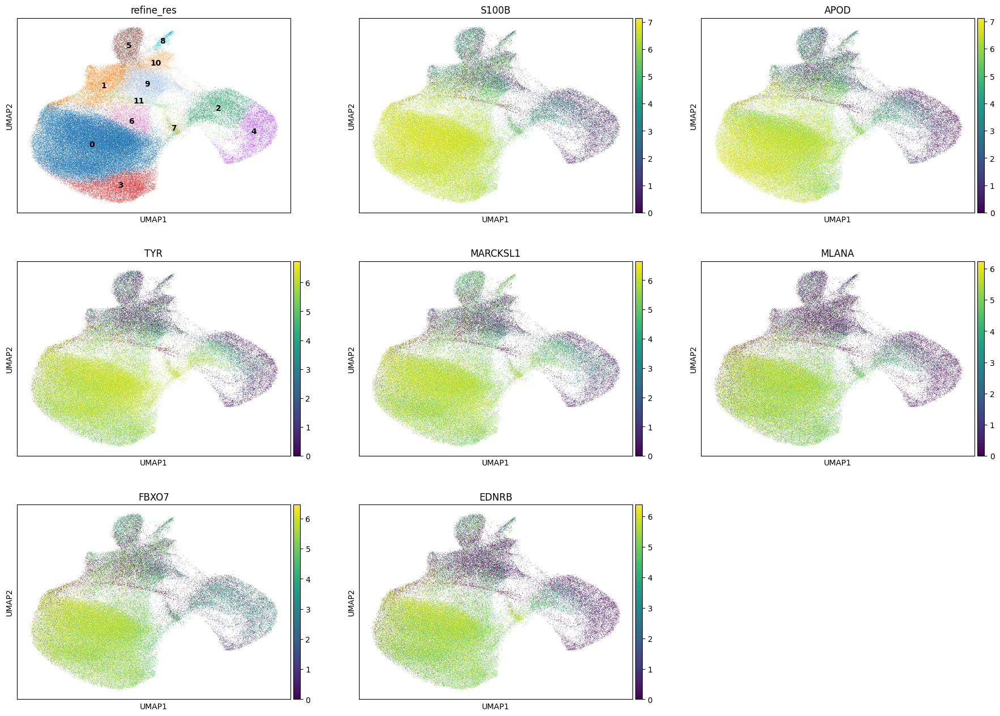

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 57632
Percentage of cells in cluster 0: 54.7


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.2. Cluster 1

In [61]:
cluster_id = '1'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,59.7
1,NA,NA,NA,15.8
2,Melanocyte,Melanocyte,normal_cell,11.5
3,Melanocyte,Melanocyte,cancer_cell,8.5
4,Fibroblast,CAF,normal_cell,2.8


In [63]:
top_ranked_genes[cluster_id]

0     FCER1G
1       CD68
2       CTSZ
3        LYZ
4        VIM
5    ARHGDIB
6       AIF1
Name: 1, dtype: object

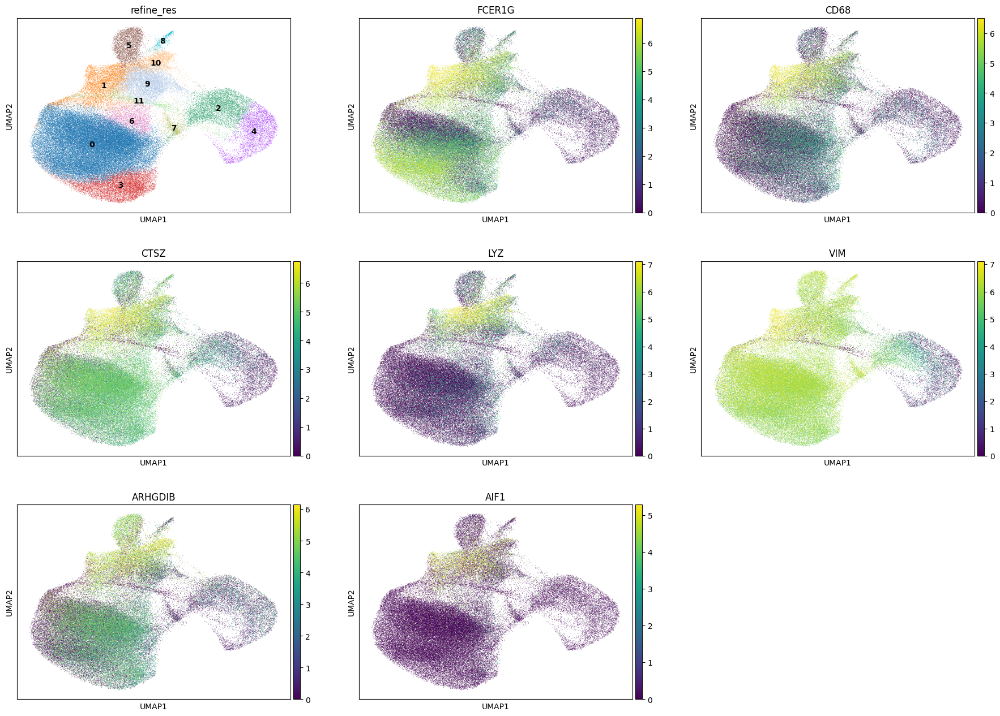

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 6941
Percentage of cells in cluster 1: 6.6


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.3. Cluster 2

In [67]:
cluster_id = '2'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Keratinocyte,normal_cell,66.2
1,Melanocyte,Melanocyte,cancer_cell,30.3
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,1.6
3,NA,NA,NA,0.9
4,Fibroblast,CAF,normal_cell,0.6


In [69]:
top_ranked_genes[cluster_id]

0       KRT5
1      KRT15
2      KRT17
3      KRT16
4    COL17A1
5        DSP
6    S100A14
Name: 2, dtype: object

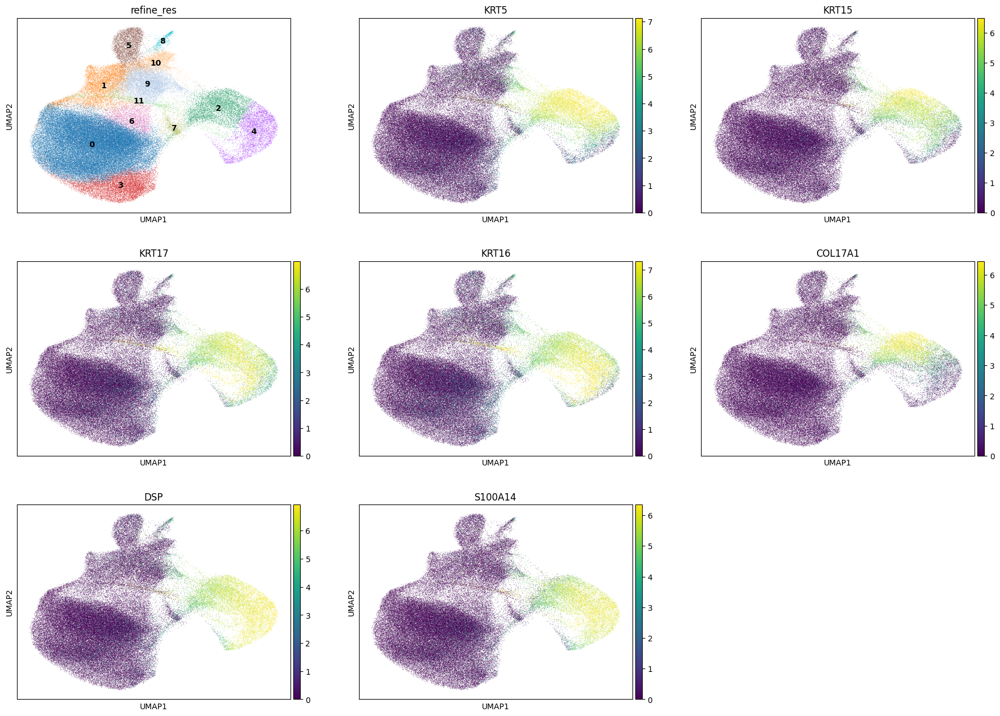

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 6359
Percentage of cells in cluster 2: 6.0


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Basal_keratinocyte'

### 5.4. Cluster 3

In [135]:
cluster_id = '3'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Melanocyte,High_proliferating_melanocyte,cancer_cell,73.5
1,Melanocyte,Melanocyte,cancer_cell,20.8
2,Melanocyte,Melanocyte,normal_cell,4.5
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.6
4,NA,NA,NA,0.5


In [75]:
top_ranked_genes[cluster_id]

0     STMN1
1     HMGN2
2      TYMS
3     TOP2A
4     PTTG1
5     HMGB2
6    NUSAP1
Name: 3, dtype: object

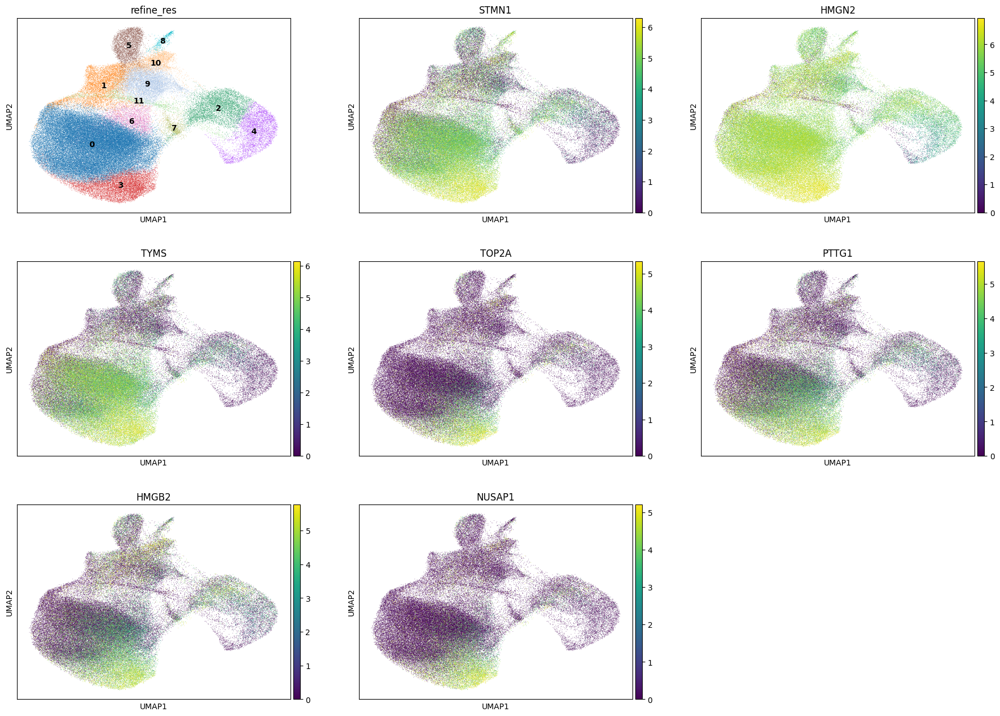

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 8844
Percentage of cells in cluster 3: 8.4


In [136]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'High_proliferating_melanocyte'

### 5.5. Cluster 4

In [80]:
cluster_id = '4'

In [81]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Keratinocyte,normal_cell,94.6
1,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,3.4
2,NA,NA,NA,1.7
3,Melanocyte,Melanocyte,cancer_cell,0.3
4,Melanocyte,High_proliferating_melanocyte,cancer_cell,0.0


In [82]:
top_ranked_genes[cluster_id]

0       PERP
1        DSP
2       DMKN
3    TACSTD2
4      LYPD3
5    S100A14
6     KRTDAP
Name: 4, dtype: object

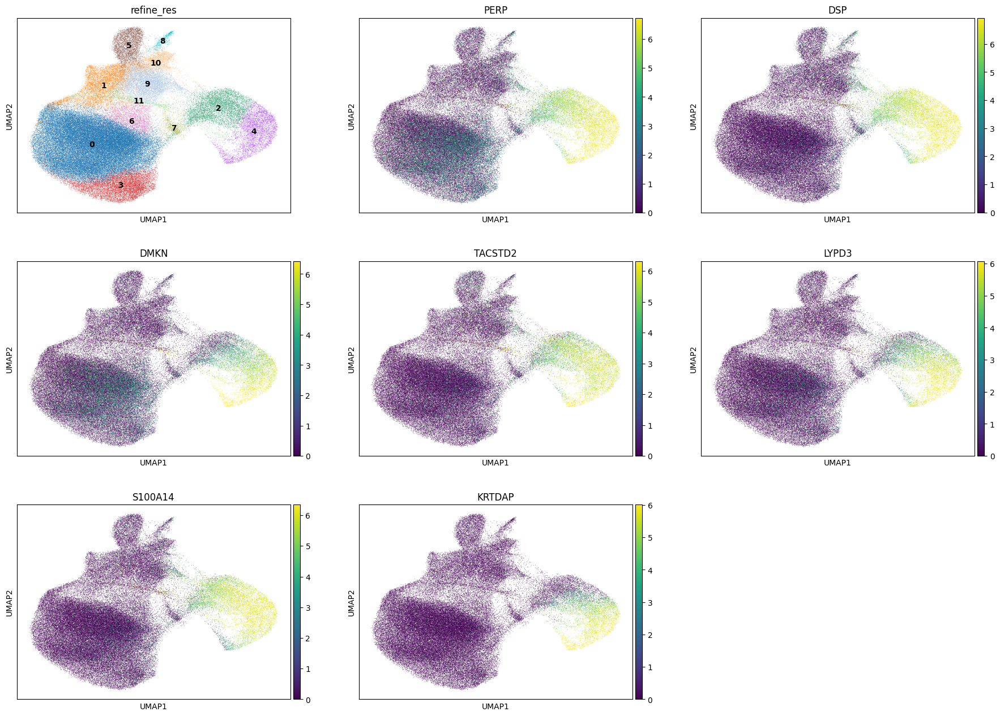

In [83]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [84]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 4683
Percentage of cells in cluster 4: 4.4


In [85]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Keratinocyte'

### 5.6. Cluster 5

In [86]:
cluster_id = '5'

In [87]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,47.1
1,Fibroblast,CAF,normal_cell,37.5
2,NA,NA,NA,8.4
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,5.6
4,Melanocyte,Melanocyte,cancer_cell,0.8


In [88]:
top_ranked_genes[cluster_id]

0      PLVAP
1       AQP1
2    SPARCL1
3        VWF
4     COL6A1
5     IGFBP7
6       CD93
Name: 5, dtype: object

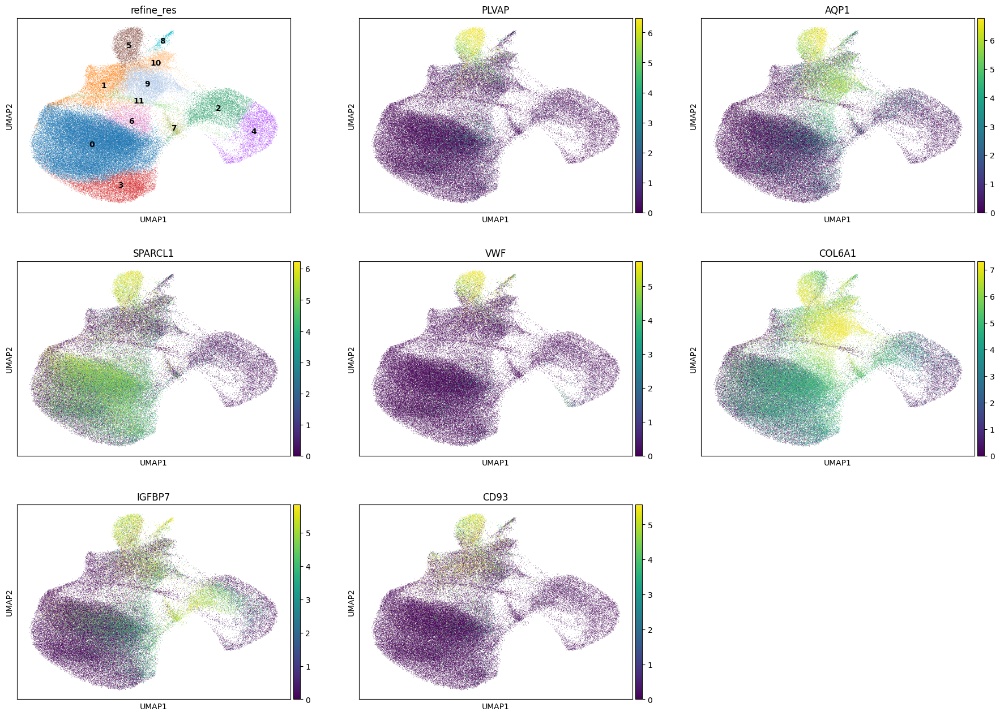

In [89]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [90]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 4107
Percentage of cells in cluster 5: 3.9


In [91]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Angiogenic_endothelial_cell'

### 5.7. Cluster 6

In [92]:
cluster_id = '6'

In [93]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Melanocyte,Melanocyte,cancer_cell,77.4
1,Melanocyte,Melanocyte,normal_cell,7.5
2,Fibroblast,CAF,normal_cell,6.6
3,Melanocyte,High_proliferating_melanocyte,cancer_cell,5.2
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,1.7


In [94]:
top_ranked_genes[cluster_id]

0    COL6A1
1    COL6A3
2    COL6A2
3       LUM
4      MMP2
5      AQP1
6    COL5A2
Name: 6, dtype: object

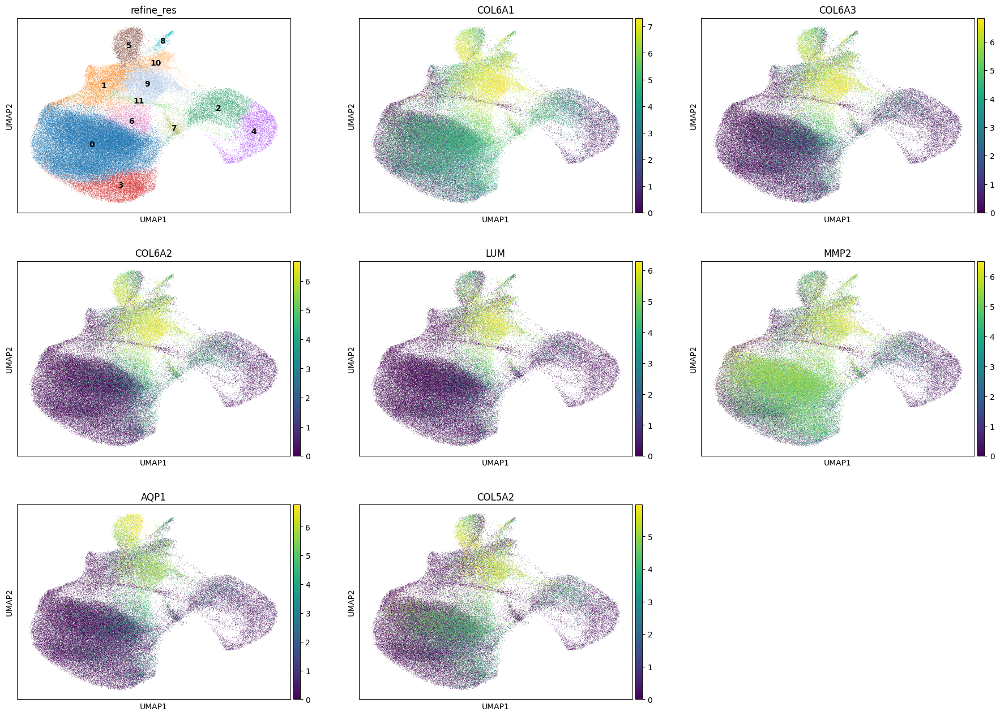

In [95]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [96]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 3272
Percentage of cells in cluster 6: 3.1


In [97]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.8. Cluster 7

In [98]:
cluster_id = '7'

In [99]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Melanocyte,Melanocyte,cancer_cell,91.8
1,Melanocyte,Melanocyte,normal_cell,2.5
2,Fibroblast,CAF,normal_cell,1.6
3,Melanocyte,High_proliferating_melanocyte,cancer_cell,1.5
4,NA,NA,NA,1.4


In [100]:
top_ranked_genes[cluster_id]

0       KIT
1     IFI27
2    APCDD1
3     TYRP1
4     TRPM1
5    IGFBP7
6    TFAP2B
Name: 7, dtype: object

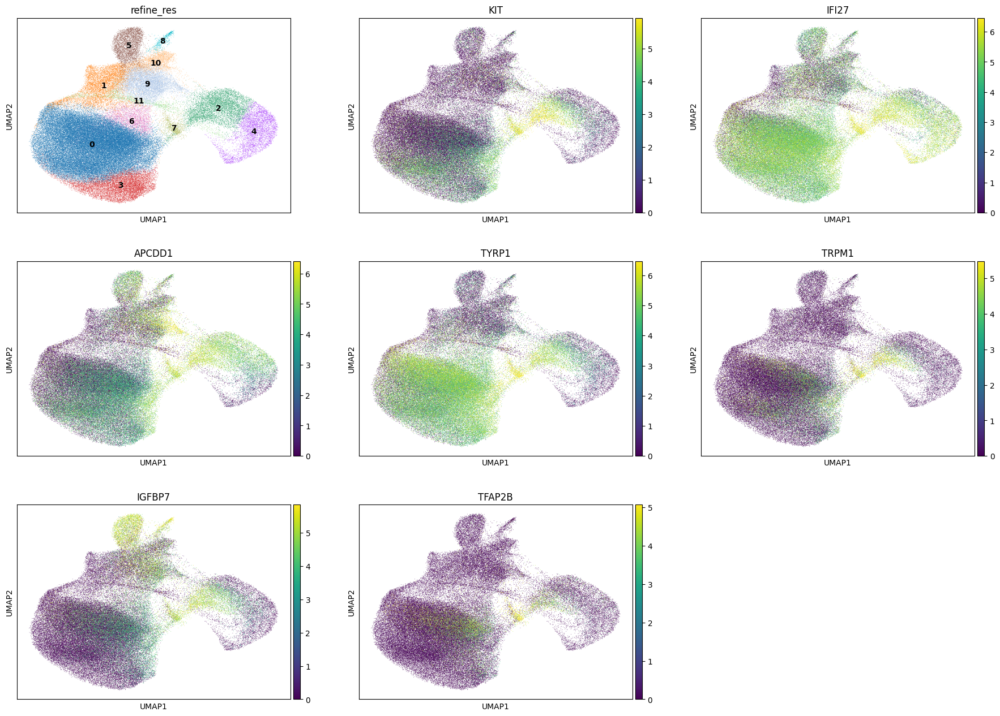

In [101]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [102]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 1111
Percentage of cells in cluster 7: 1.1


In [103]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.9. Cluster 8

In [104]:
cluster_id = '8'

In [105]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,50.9
1,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,21.2
2,Fibroblast,CAF,normal_cell,13.3
3,Melanocyte,Melanocyte,cancer_cell,7.8
4,NA,NA,NA,4.9


In [106]:
top_ranked_genes[cluster_id]

0     MMRN1
1     GNG11
2     PROX1
3     LYVE1
4      TFPI
5      CDH5
6    IGFBP7
Name: 8, dtype: object

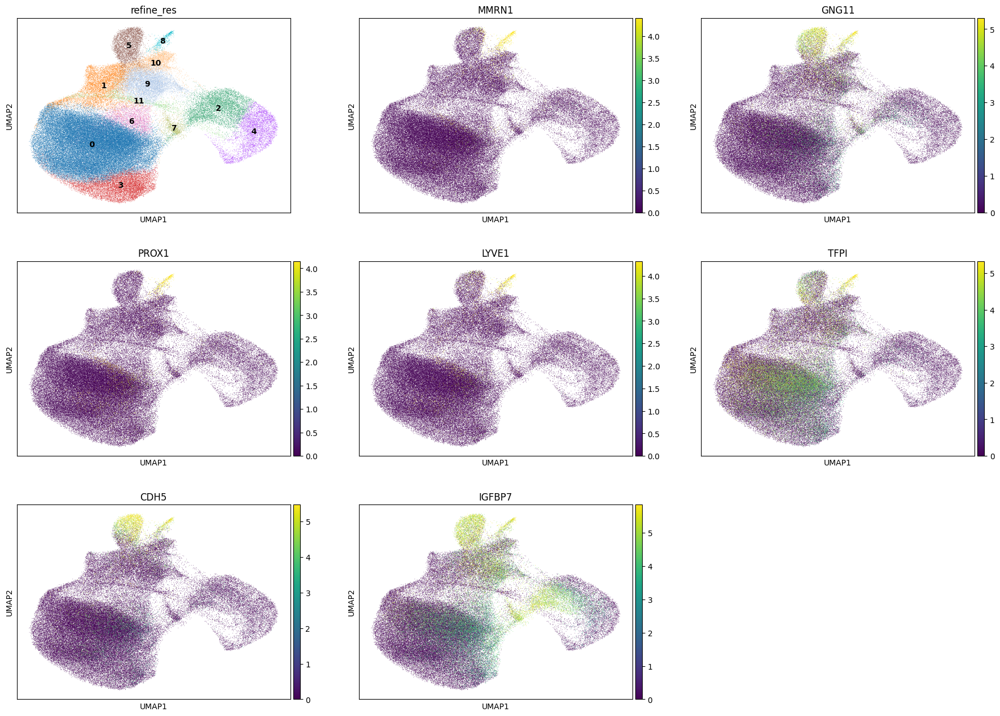

In [107]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [108]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 631
Percentage of cells in cluster 8: 0.6


In [109]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.10. Cluster 9

In [110]:
cluster_id = '9'

In [111]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,55.1
1,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,28.8
2,NA,NA,NA,11.5
3,Melanocyte,Melanocyte,normal_cell,2.1
4,Melanocyte,Melanocyte,cancer_cell,1.6


In [112]:
top_ranked_genes[cluster_id]

0    COL6A1
1    COL6A3
2    COL6A2
3       LUM
4      AQP1
5    COL5A2
6      MMP2
Name: 9, dtype: object

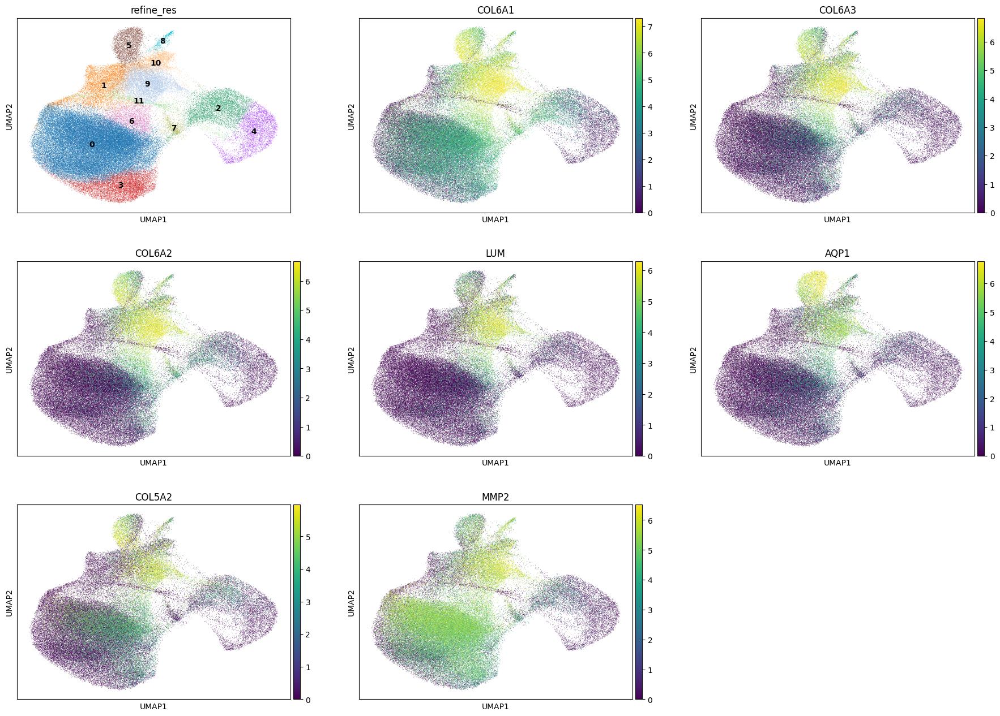

In [113]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [114]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 7545
Percentage of cells in cluster 9: 7.2


In [116]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.11. Cluster 10

In [117]:
cluster_id = '10'

In [118]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,84.9
1,NA,NA,NA,7.7
2,Fibroblast,CAF,normal_cell,3.5
3,Melanocyte,Melanocyte,cancer_cell,1.9
4,Melanocyte,Melanocyte,normal_cell,0.7


In [119]:
top_ranked_genes[cluster_id]

0    ARHGDIB
1        LYZ
2     COL6A1
3       CD3E
4       CD3D
5     COL6A3
6       CD8A
Name: 10, dtype: object

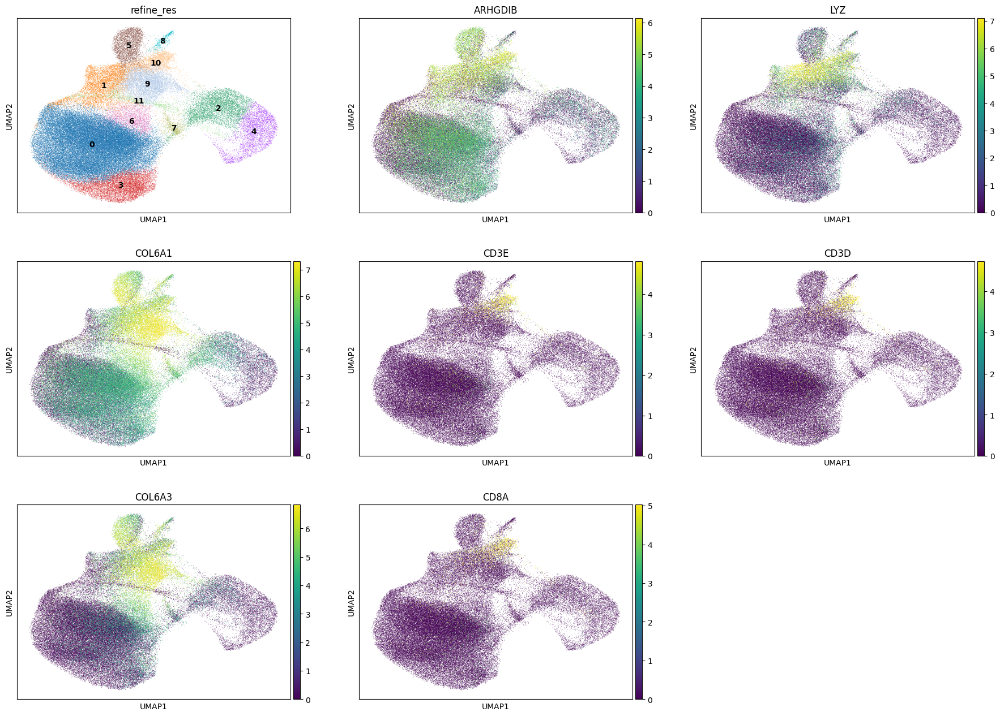

In [121]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [122]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 2689
Percentage of cells in cluster 10: 2.6


In [123]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.12. Cluster 11

In [124]:
cluster_id = '11'

In [125]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,86.3
1,Epithelial,Keratinocyte,normal_cell,6.2
2,Melanocyte,Melanocyte,normal_cell,4.0
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,1.6
4,Fibroblast,CAF,normal_cell,1.1


In [126]:
top_ranked_genes[cluster_id]

0      KRT16
1      KRT17
2       KRT5
3    TACSTD2
4       SLPI
5       SBSN
6        DSP
Name: 11, dtype: object

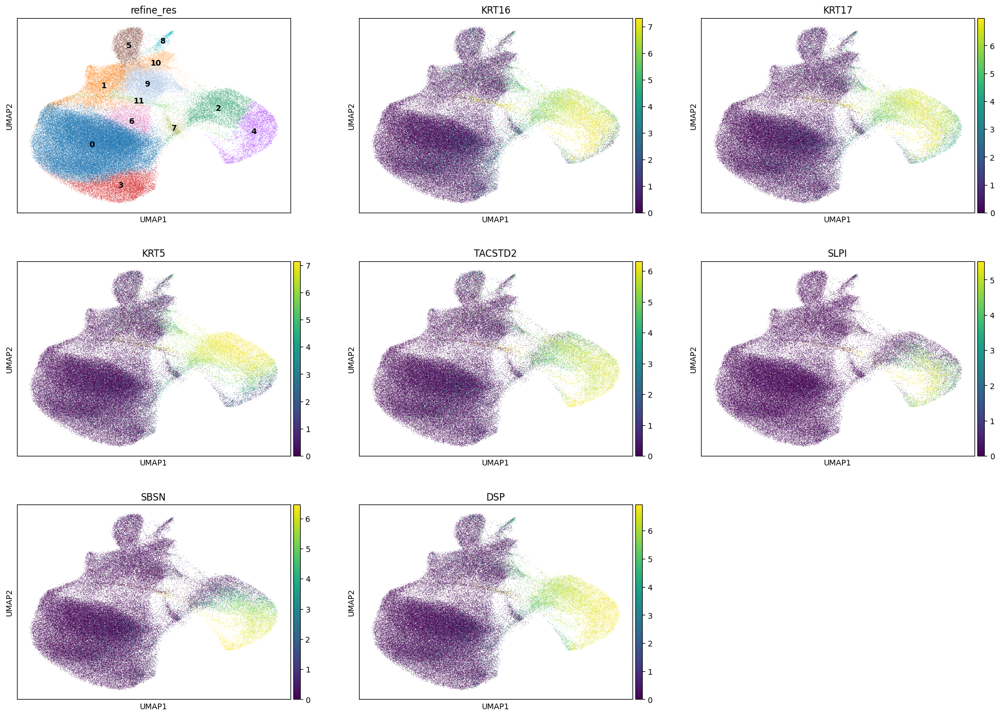

In [128]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [129]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 1489
Percentage of cells in cluster 11: 1.4


In [130]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Keratinocyte'

## 6. Cancer cells

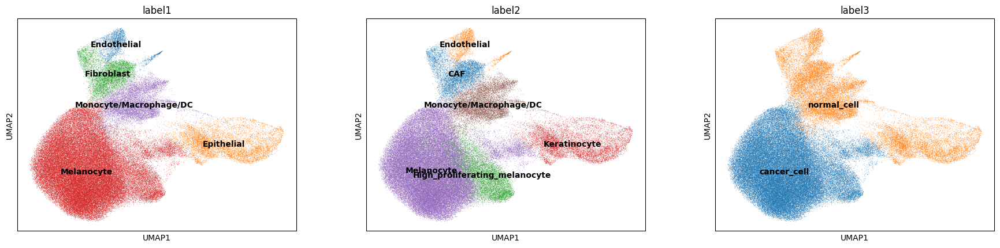

In [4]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

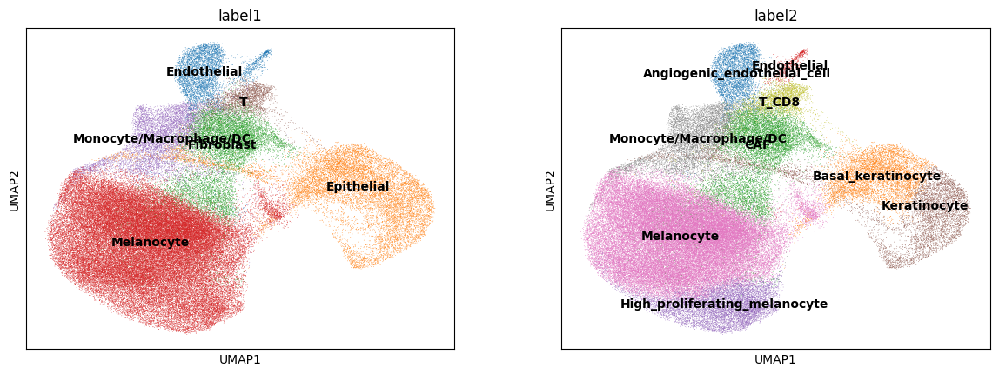

In [137]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [138]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Melanocyte']), 'label3'] = 'cancer_cell'

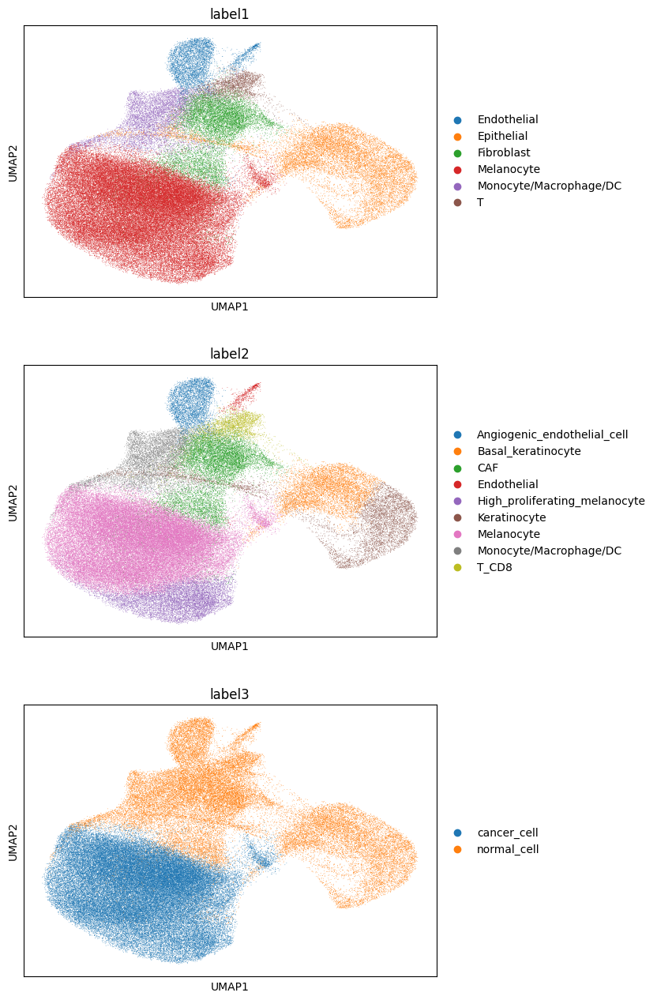

In [140]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [141]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,pca_n10_pcs16_leiden_res0.8,label3
0,aaaaaaaa-1,34,0,0,0,0,34,640.225336,12.056719,cell_labels,1,7,10,11,Epithelial,Keratinocyte,15,normal_cell
1,aaaaaaab-1,17,0,0,0,0,17,570.504083,8.173282,cell_labels,1,7,10,11,Epithelial,Keratinocyte,15,normal_cell
2,aaaaaaac-1,1217,0,0,1,0,1218,581.025490,45.698127,cell_labels,2,4,6,2,Epithelial,Basal_keratinocyte,6,normal_cell
3,aaaaaaad-1,296,0,0,0,0,296,296.270167,16.211094,cell_labels,3,3,3,3,Melanocyte,High_proliferating_melanocyte,3,cancer_cell
4,aaaaaaae-1,61,0,0,0,0,61,800.891279,11.560000,cell_labels,1,7,10,11,Epithelial,Keratinocyte,15,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106975,aaabkbnp-1,157,0,0,0,0,157,95.099066,24.610157,cell_labels,2,4,6,2,Epithelial,Basal_keratinocyte,6,normal_cell
106976,aaabkboa-1,300,0,0,0,0,300,206.905945,11.424532,cell_labels,2,4,7,4,Epithelial,Keratinocyte,11,normal_cell
106977,aaabkbob-1,37,0,0,0,0,37,339.529856,17.656094,cell_labels,1,1,1,9,Fibroblast,CAF,4,normal_cell
106978,aaabkboc-1,72,0,0,0,0,72,117.677192,14.991876,cell_labels,1,1,1,9,Fibroblast,CAF,4,normal_cell


In [142]:
adata_cells.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")